In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
from PIL import Image
import matplotlib.image as mpimg

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image as image_utils

from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense

In [3]:
image_dir = './Jaws_labeled_images'

In [4]:
# Input image dimensions, etc.
resized_height = 224
resized_width = 224
num_channel = 3 
num_classes = 18
batch_size = 32 

In [5]:
# load train images without batching
train_images = image_dataset_from_directory(
    image_dir, labels='inferred', label_mode='categorical',
     color_mode='rgb', image_size=(resized_height ,
    resized_width ), batch_size=32, shuffle=True, seed=42, validation_split=0.2, subset='training',
    interpolation='bilinear', follow_links=False,
    crop_to_aspect_ratio=False)
print(train_images)

Found 112 files belonging to 18 classes.
Using 90 files for training.


2024-04-16 20:00:44.006215: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 79087 MB memory:  -> device: 0, name: NVIDIA A100-SXM4-80GB, pci bus id: 0000:87:00.0, compute capability: 8.0


<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 18), dtype=tf.float32, name=None))>


['Carcharhinidae', 'Carcharhinus', 'Carcharhinus_brachyurus', 'Carcharhinus_leucas', 'Carcharhinus_limbatus', 'Carcharhinus_perezi', 'Carcharias_taurus', 'Carcharodon_carcharias', 'Galeocerdo_cuvier', 'Ginglymostoma_cirratum', 'Isistius_brasiliensis', 'Isurus_oxyrhinchus', 'Nebrius_ferrugineus', 'Negaprion_acutidens', 'Orectolobus', 'Orectolobus_ornatus', 'Squatina', 'Triaenodon_obesus\xa0']
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)


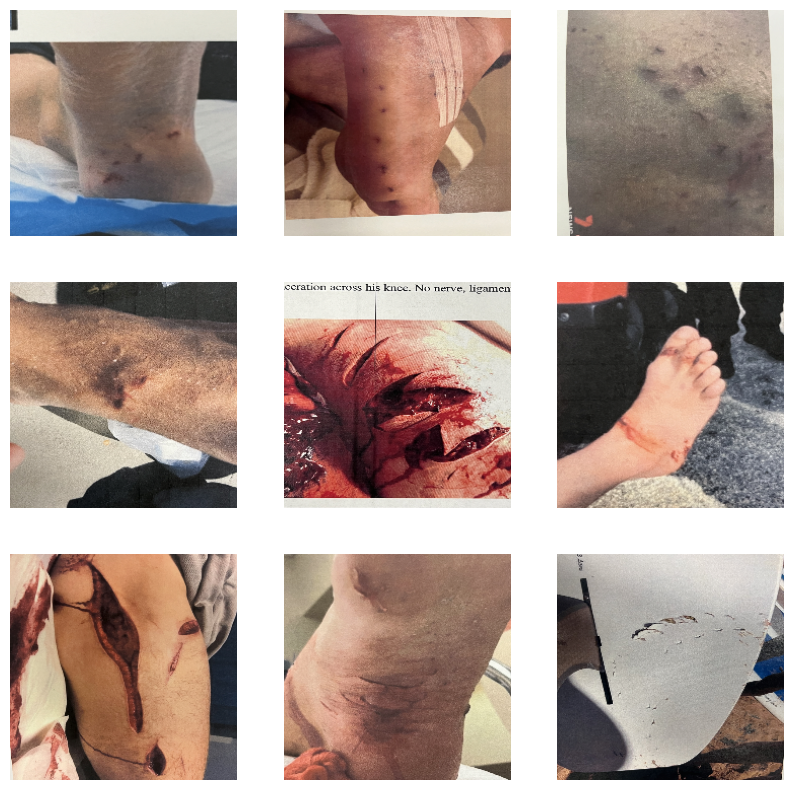

In [6]:
# Note that the images have been loaded with 3 color channels!
class_names = train_images.class_names
print(class_names)
plt.figure(figsize=(10, 10))
for images, labels in train_images.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    #plt.title(class_names[labels[i]])
    plt.axis("off")
    print(images[i].shape)

In [7]:
for images, labels in train_images.take(1):
    image_array = np.array(images)
    label_array = np.array(labels)
    print("Images batch shape:", image_array.shape)
    print("Labels batch shape:", label_array.shape)


Images batch shape: (32, 224, 224, 3)
Labels batch shape: (32, 18)


In [8]:
from keras.preprocessing.image import ImageDataGenerator

datagen = ImageDataGenerator(
        rotation_range=40,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest')


In [8]:
# from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img

# def augment_images(image, label):
#     image = datagen.random_transform(image)
#     return image, label
# input_shape = (224, 224, 3)

# augmented_dataset = train_images.map(augment_images)

In [9]:
# # test script with one image
# img = load_img('./Jaws_labeled_images/Carcharhinidae/IMG_0180_Large.png')
# x = img_to_array(img)
# x = x.reshape((1,) + x.shape)
# print(x.shape)

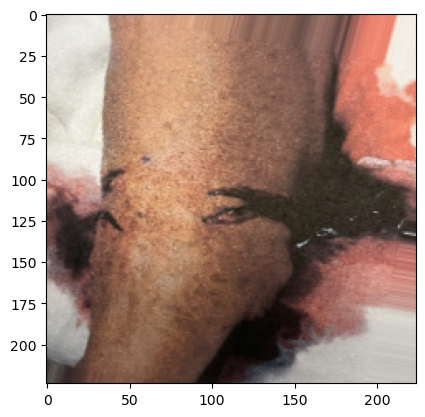

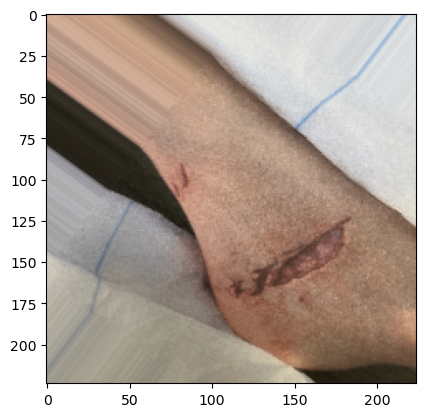

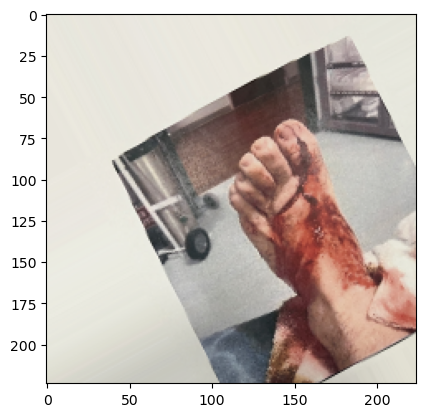

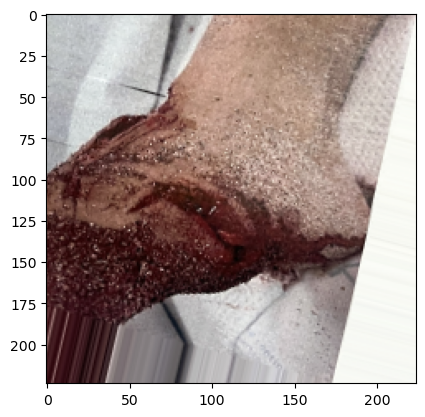

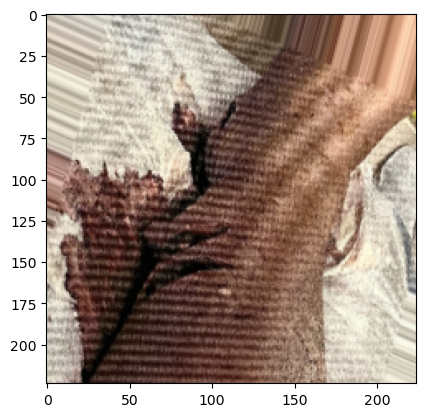

...

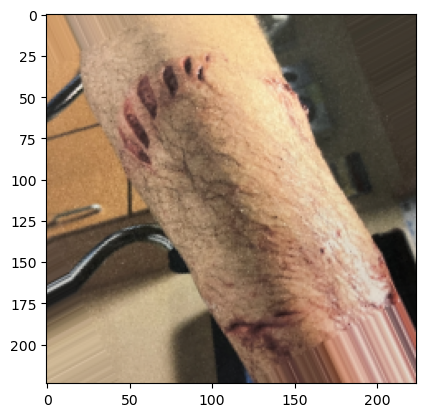

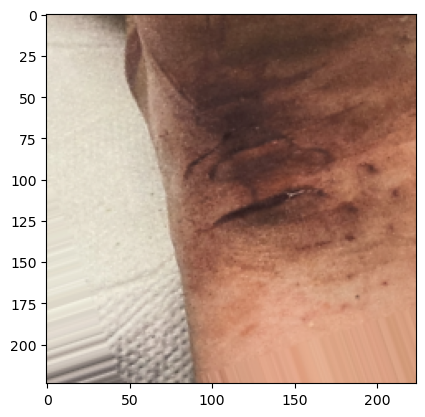

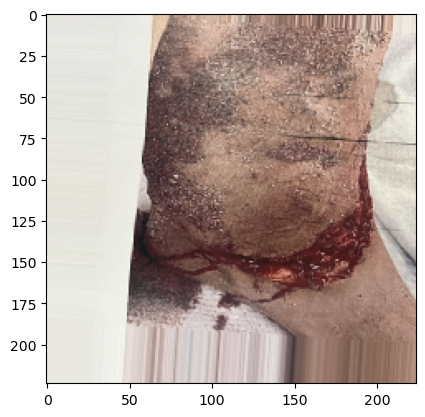

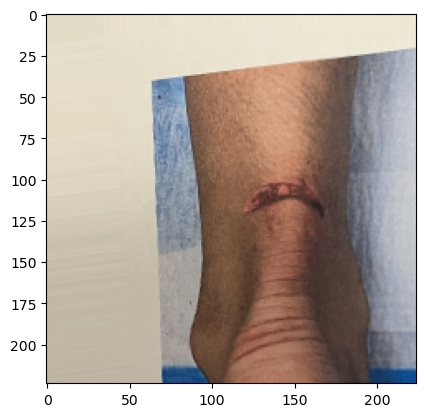

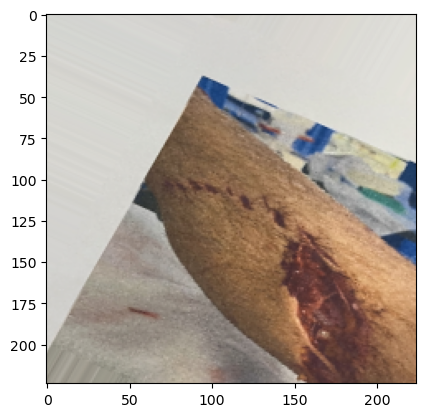

In [9]:
augmented_images = datagen.flow(image_array)

for i in range(batch_size):
    augmented_image = next(augmented_images)[0]  # Retrieve the augmented image from the generator
    plt.imshow(augmented_image.astype('uint8')) # Plot the augmented image
    plt.show()

(32, 224, 224, 3) (32, 18)


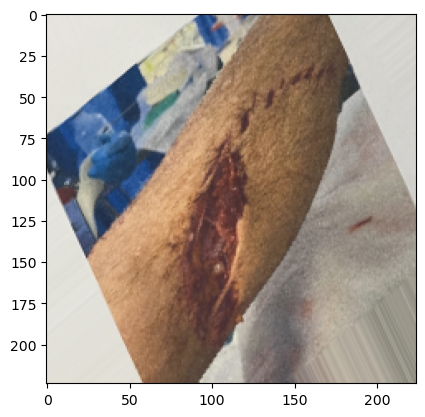

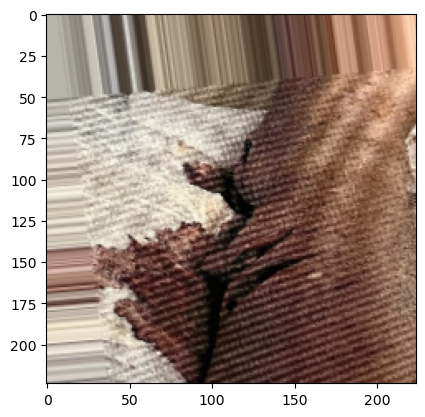

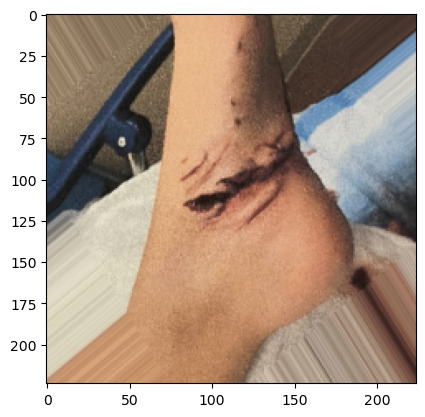

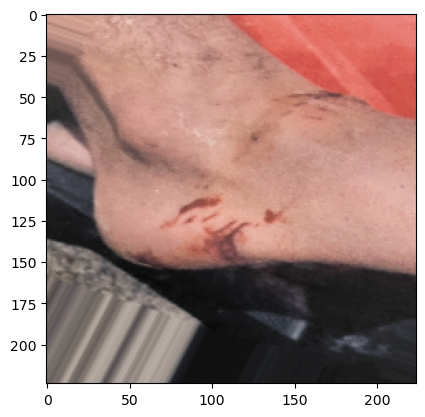

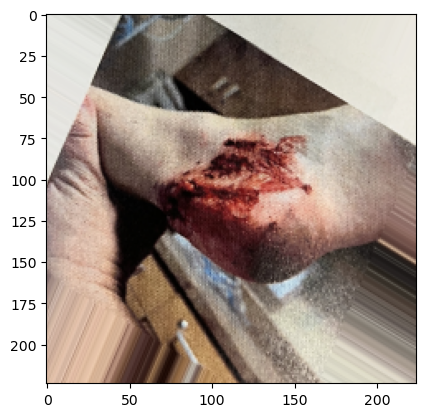

...

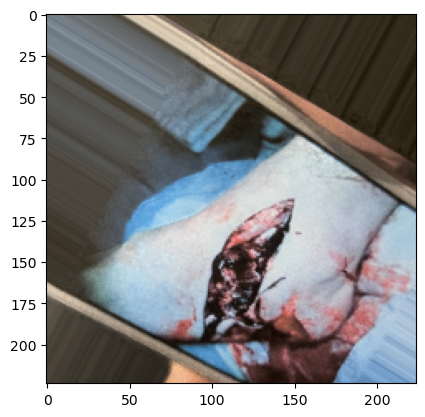

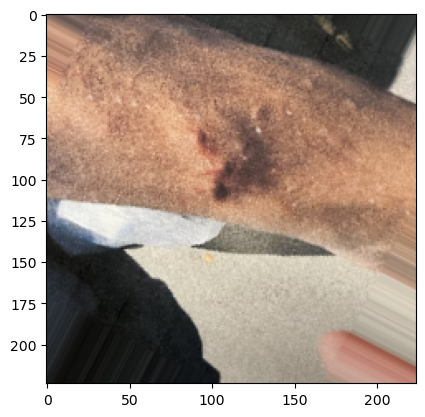

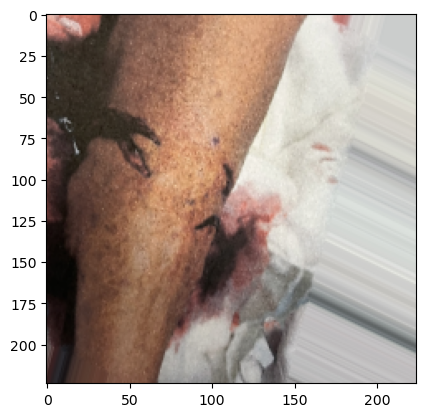

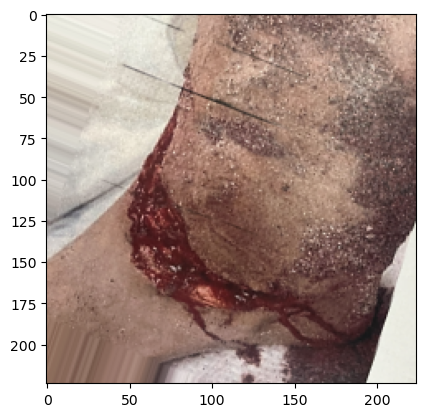

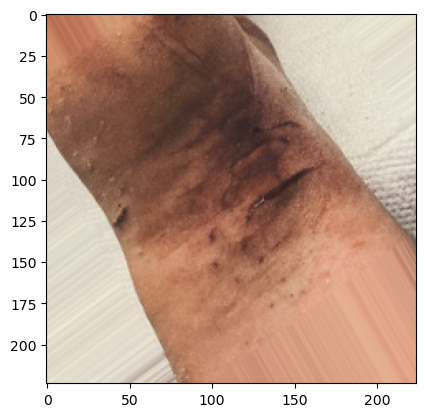

In [10]:
# # Reshape the image to (1, height, width, channels) for the datagen.flow() method
# image = np.expand_dims(x, axis=0)

# Generate augmented images indefinitely
augmented_images = datagen.flow(image_array, label_array, batch_size=batch_size)

x, y = next(augmented_images)
print(x.shape, y.shape)
# fig, ax = plt.subplots(nrows=4, ncols=8)
for i in range(batch_size):
    image = x[i]
#     ax.flatten()[i].imshow(np.squeeze(image))
    plt.imshow(image.astype('uint8'))
    plt.show()



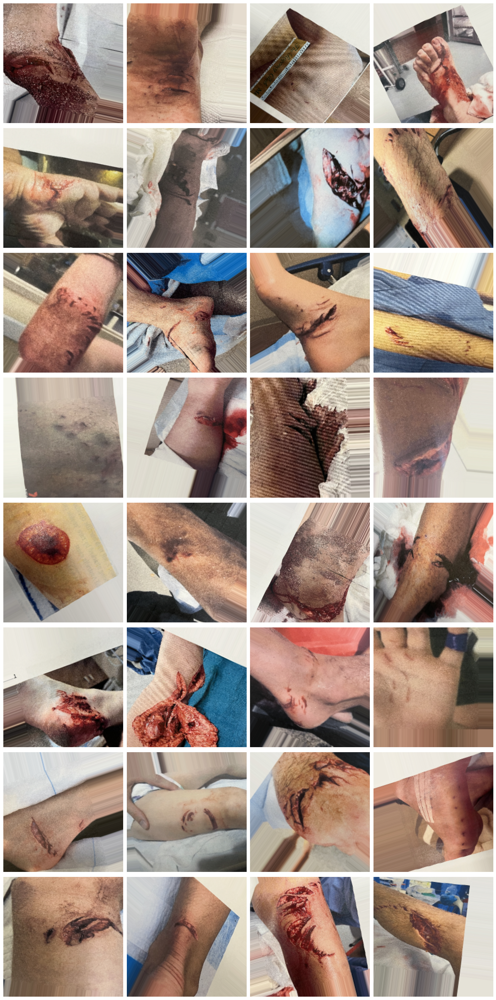

In [11]:
augmented_images = datagen.flow(image_array, label_array, batch_size=batch_size)

x, y = next(augmented_images)

num_rows = 8
num_cols = 4

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 30))

for i in range(batch_size):
    row = i // num_cols
    col = i % num_cols
    augmented_image = x[i]
    axes[row, col].imshow(augmented_image.astype('uint8'))  # Plot the augmented image
    axes[row, col].axis('off')  # Turn off axis labels

plt.tight_layout()
plt.show()

# Below are test scripts

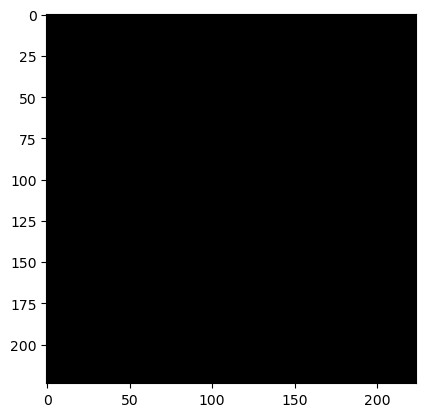

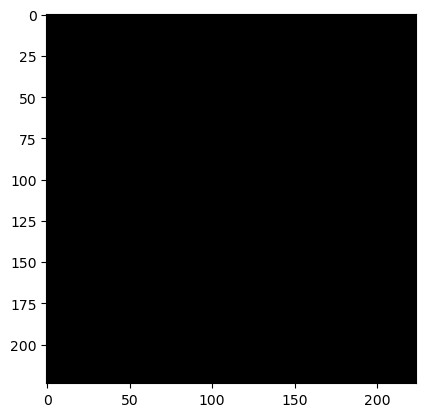

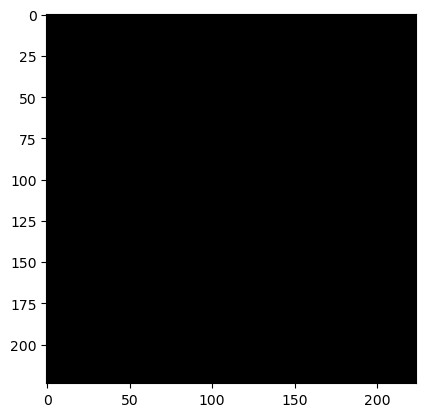

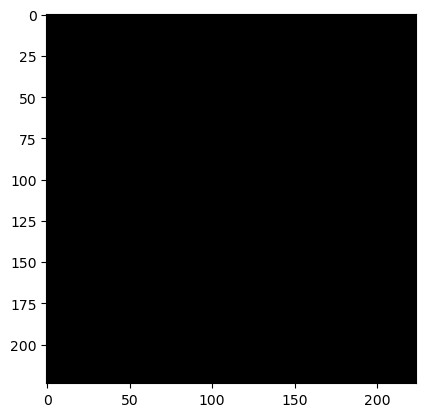

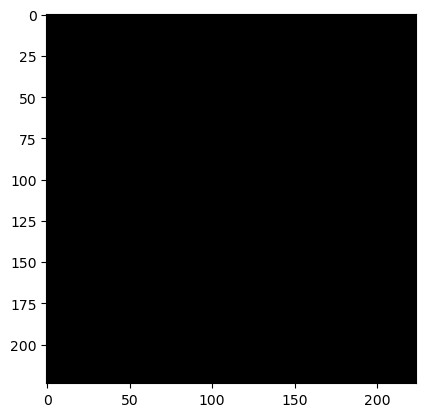

In [17]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define an ImageDataGenerator with augmentation parameters
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Load a sample image
image = np.random.random((224, 224, 3))

# Reshape the image to (1, height, width, channels) for the datagen.flow() method
image = np.expand_dims(image, axis=0)

# Generate augmented images indefinitely
augmented_images = datagen.flow(image)

# Specify how many augmented images you want to generate
num_images_to_generate = 5

# Generate and plot the specified number of augmented images
for i in range(num_images_to_generate):
    augmented_image = next(augmented_images)[0]  # Retrieve the augmented image from the generator
    plt.imshow(augmented_image.astype('uint8'))  # Plot the augmented image
    plt.show()


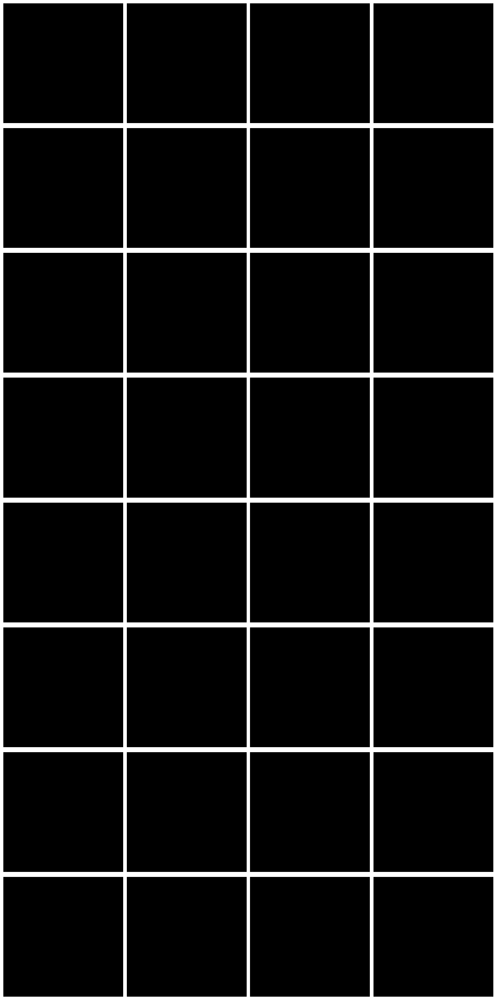

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define an ImageDataGenerator with augmentation parameters
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Load a sample image
image = np.random.random((224, 224, 3))

# Reshape the image to (1, height, width, channels) for the datagen.flow() method
image = np.expand_dims(image, axis=0)

# Generate augmented images indefinitely
augmented_images = datagen.flow(image)

# Generate and plot 32 augmented images in an 8x4 grid plot
num_images_to_generate = 32
num_rows = 8
num_cols = 4

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 30))

for i in range(num_images_to_generate):
    row = i // num_cols
    col = i % num_cols
    augmented_image = next(augmented_images)[0]  # Retrieve the augmented image from the generator
    axes[row, col].imshow(augmented_image.astype('uint8'))  # Plot the augmented image
    axes[row, col].axis('off')  # Turn off axis labels

plt.tight_layout()
plt.show()


### Model 

In [38]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout


model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    MaxPooling2D(2, 2),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(512, activation='relu'),
    Dropout(0.5),
    Dense(num_classes, activation='softmax') 
])

In [39]:
from tensorflow.keras.optimizers import Adam

model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

In [40]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image_dataset_from_directory

# Load the training dataset 
train_images = image_dataset_from_directory(
    image_dir,
    labels='inferred',
    label_mode='categorical',
    color_mode='rgb',
    image_size=(224, 224),
    batch_size=batch_size,  
    shuffle=True,
    seed=42,
    validation_split=0.2,
    subset='training',
    interpolation='bilinear'
)

# Load validation dataset
val_ds = image_dataset_from_directory(
    image_dir,
    validation_split=0.2,  
    subset="validation",
    seed=42,  
    image_size=(224, 224),
    batch_size=batch_size,
    label_mode='categorical',  
    shuffle=True  
)

# Ensure the train_images dataset is suitable for model training
train_images = train_images.prefetch(buffer_size=32)

Found 112 files belonging to 18 classes.
Using 90 files for training.
Found 112 files belonging to 18 classes.
Using 22 files for validation.


In [41]:
from tensorflow.keras.callbacks import EarlyStopping


early_stopper = EarlyStopping(
    monitor='val_loss',  # Monitor the validation loss
    patience=5,          # Number of epochs with no improvement after which training will be stopped
    restore_best_weights=True  # Restores model weights from the epoch with the best value of the monitored quantity
)

# Train the model
history = model.fit(
    train_images,  
    epochs=10,  
    validation_data=val_ds,
    callbacks=[early_stopper]
)

Epoch 1/10
3/3 [==============================] - 4s 423ms/step - loss: 735.2272 - accuracy: 0.2111 - val_loss: 278.4229 - val_accuracy: 0.0000e+00
Epoch 2/10
3/3 [==============================] - 2s 288ms/step - loss: 132.3394 - accuracy: 0.2444 - val_loss: 47.4508 - val_accuracy: 0.1364
Epoch 3/10
3/3 [==============================] - 3s 320ms/step - loss: 29.8538 - accuracy: 0.2222 - val_loss: 7.5968 - val_accuracy: 0.0909
Epoch 4/10
3/3 [==============================] - 3s 235ms/step - loss: 4.2589 - accuracy: 0.3556 - val_loss: 10.9197 - val_accuracy: 0.0909
Epoch 5/10
3/3 [==============================] - 3s 412ms/step - loss: 4.4618 - accuracy: 0.4000 - val_loss: 3.7812 - val_accuracy: 0.4545
Epoch 6/10
3/3 [==============================] - 3s 281ms/step - loss: 0.4231 - accuracy: 0.9000 - val_loss: 5.6167 - val_accuracy: 0.3636
Epoch 7/10
3/3 [==============================] - 3s 285ms/step - loss: 0.1434 - accuracy: 0.9667 - val_loss: 11.3585 - val_accuracy: 0.3636
Epoch 

In [42]:
val_loss, val_accuracy = model.evaluate(val_ds)
print("Validation loss:", val_loss)
print("Validation accuracy:", val_accuracy)

1/1 [==============================] - 0s 425ms/step - loss: 3.7812 - accuracy: 0.4545
Validation loss: 3.781243085861206
Validation accuracy: 0.4545454680919647


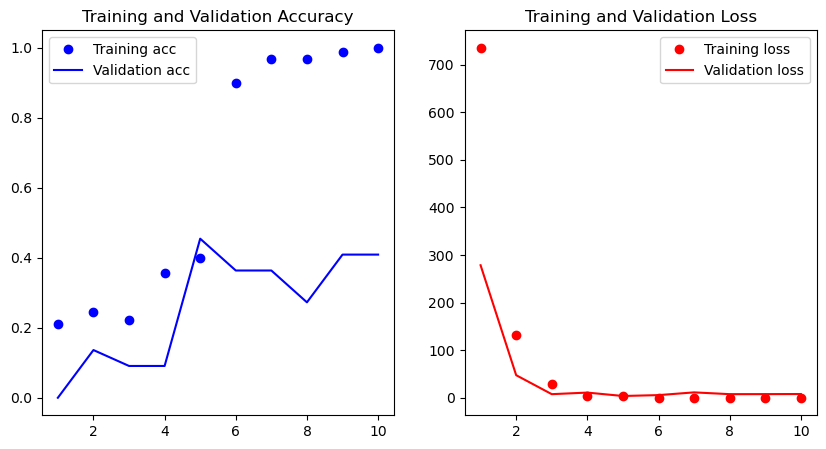

In [43]:
import matplotlib.pyplot as plt

acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(acc) + 1)

# Accuracy plot
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and Validation Accuracy')
plt.legend()

# Loss plot
plt.subplot(1, 2, 2)
plt.plot(epochs, loss, 'ro', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and Validation Loss')
plt.legend()

plt.show()

1/1 [==============================] - 1s 805ms/step


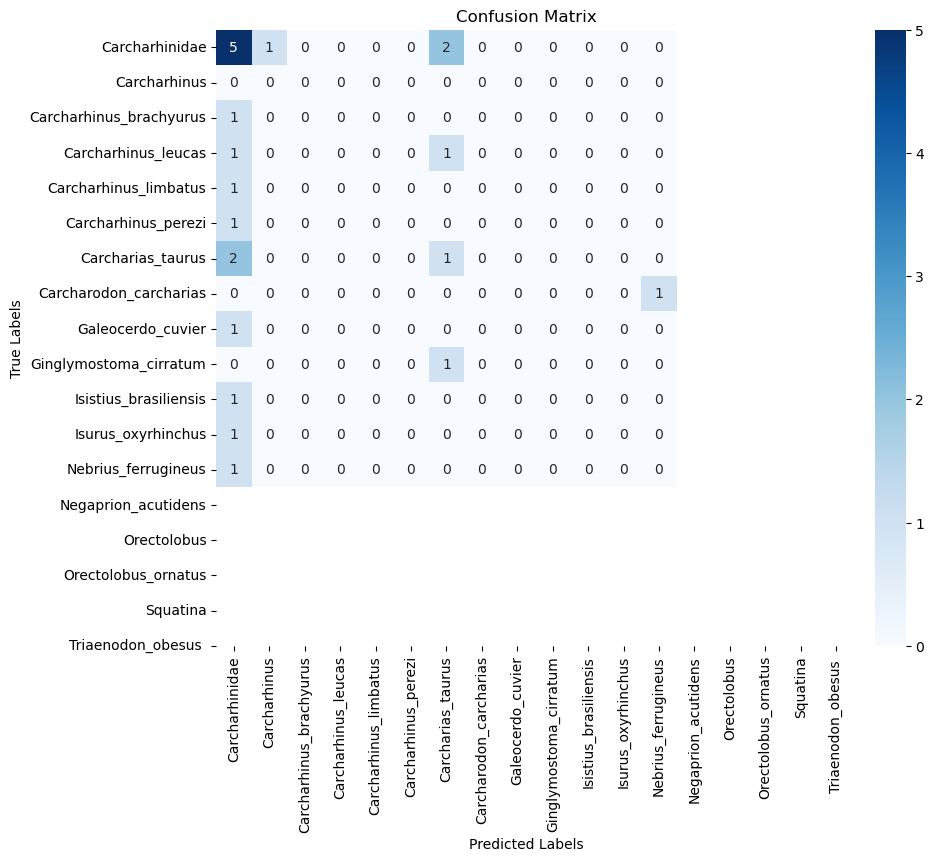

In [45]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

val_predictions = model.predict(val_ds)
val_predictions = np.argmax(val_predictions, axis=1)  # Convert probabilities to class indices

# Convert one-hot encoded labels to class indices
true_labels = np.concatenate([y.numpy() for _, y in val_ds])
true_labels = np.argmax(true_labels, axis=1)  # Convert from one-hot to class indices

# Compute the confusion matrix
conf_mat = confusion_matrix(true_labels, val_predictions)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(conf_mat, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()